Author: Heather Lemon

Date: July 31, 2023

Data Set: https://www.kaggle.com/datasets/teejmahal20/airline-passenger-satisfaction 

Data Feature Description:

| Variable   |      Definition      |  Key |
|----------|:-------------:|------:|
| Id  | user id | |
| Gender |  Gender of passengers | Male, Female |
| Customer Type |    The customer type   |   Loyal customer, disloyal customer |
| Age |    The actual age of the passengers | 5 -90    |
| Type of Travel | Purpose of the flight of the passengers | Personal Travel, Business Travel |
| Class | Travel class in the plane of the passengers | Business, Eco, Eco Plus |
| Flight distance | The flight distance of this journey (Miles) | 0 - 6000  |
| Inflight wifi service |  Satisfaction level of the inflight wifi service |  0:Not Applicable; 1-5   |
| Departure/Arrival time | Satisfaction level of Departure/Arrival time | 0:Not Applicable; 1-5    |
| Ease of Online booking |  Satisfaction level of online booking | 0:Not Applicable; 1-5  |
| Gate location | Satisfaction level of Gate location | 0:Not Applicable; 1-5  |
| Food and drink | Satisfaction level of Food and drink |  0:Not Applicable; 1-5 |
| Online boarding |  Satisfaction level of online boarding | 0:Not Applicable; 1-5   |
| Seat comfort | Satisfaction level of Seat comfort | 0:Not Applicable; 1-5   |
| Inflight entertainment | Satisfaction level of inflight entertainment | 0:Not Applicable; 1-5    |
| On-board service | Satisfaction level of On-board service | 0:Not Applicable; 1-5   |
| Leg room service   | Satisfaction level of Leg room service  | 0:Not Applicable; 1-5 |
| Baggage handling  | Satisfaction level of baggage handling  | 0:Not Applicable; 1-5 |
| Check-in service  | Satisfaction level of Check-in service |   0:Not Applicable; 1-5 |
| Inflight service  | Satisfaction level of inflight service  | 0:Not Applicable; 1-5 |
| Cleanliness | Satisfaction level of Cleanliness  | 0:Not Applicable; 1-5 | 
| Departure Delay in Minutes   |  Minutes delayed when departure  | 0 - 2000 |
| Arrival Delay in Minutes   | Minutes delayed when Arrival   | 0 - 2000 | 
| Satisfaction  |  Airline satisfaction level | Satisfaction, neutral or dissatisfaction |

In [379]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
from prettytable import PrettyTable
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, mean_squared_error, classification_report
import plotly.express as px

### Ingest Data

Ingest csv files and merge into one file for data cleaning prep. 

In [380]:
train_df = pd.read_csv('train.csv')
test_df = pd.read_csv('test.csv')

train_df.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


We can already highlight a few items that need to be cleaned; 
- The first two columns of the dataset can be dropped
- We can drop the words customer and travel as those are excessive 
- Convert the text columns to all lower case 
- Data type check
- Null checks 
- Parsing of the outcome column for the 3 different variables
- arrival delay in minutes is a float? Should we round and convert to int? Is it counting .5 as half an hour?

Don't forget to check imbalanced dataset (EDA step)

But before we get ahead of ourselves, lets merge the train and test together to we don't need to execute the cleaning step multiple times.

In [381]:
data = train_df.merge(test_df, how='outer')
data.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


In [382]:
data.shape

(129880, 25)

In [383]:
data.drop(labels=['Unnamed: 0', 'id'], axis=1, inplace=True)
data.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


Remove superfluous words

In [384]:
data['Customer Type'] = data['Customer Type'].apply(lambda x: x.replace('Customer', ""))
data['Type of Travel'] = data['Type of Travel'].apply(lambda y: y.replace('travel', ""))
data['Type of Travel'] = data['Type of Travel'].apply(lambda y: y.replace('Travel', ""))
data.head(3)

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,Male,Loyal,13,Personal,Eco Plus,460,3,4,3,1,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,Male,disloyal,25,Business,Business,235,3,2,3,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,Female,Loyal,26,Business,Business,1142,2,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied


Change column names to lowercase

In [385]:
data.columns = data.columns.str.lower()
data.head(3)

,gender,customer type,age,type of travel,class,flight distance,inflight wifi service,departure/arrival time convenient,ease of online booking,gate location,...,inflight entertainment,on-board service,leg room service,baggage handling,checkin service,inflight service,cleanliness,departure delay in minutes,arrival delay in minutes,satisfaction
0,Male,Loyal,13,Personal,Eco Plus,460,3,4,3,1,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,Male,disloyal,25,Business,Business,235,3,2,3,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,Female,Loyal,26,Business,Business,1142,2,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied


Select only categorical/string columns and clean the text

In [386]:
for s_column in data.select_dtypes(include='object'): 
    data[s_column] = data[s_column].str.lower()

data.head(3)

,gender,customer type,age,type of travel,class,flight distance,inflight wifi service,departure/arrival time convenient,ease of online booking,gate location,...,inflight entertainment,on-board service,leg room service,baggage handling,checkin service,inflight service,cleanliness,departure delay in minutes,arrival delay in minutes,satisfaction
0,male,loyal,13,personal,eco plus,460,3,4,3,1,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,male,disloyal,25,business,business,235,3,2,3,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,female,loyal,26,business,business,1142,2,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied


### Null Check 

In [387]:
data.isnull().sum()

gender                                 0
customer type                          0
age                                    0
type of travel                         0
class                                  0
flight distance                        0
inflight wifi service                  0
departure/arrival time convenient      0
ease of online booking                 0
gate location                          0
food and drink                         0
online boarding                        0
seat comfort                           0
inflight entertainment                 0
on-board service                       0
leg room service                       0
baggage handling                       0
checkin service                        0
inflight service                       0
cleanliness                            0
departure delay in minutes             0
arrival delay in minutes             393
satisfaction                           0
dtype: int64

We have quite a number of nulls in arrival delay column. 

We can impute or drop them. 

Let's try dropping them as the ratio is small 
393/129880 ~ 0.003% of our data.

In [388]:
data.dropna(inplace=True)
data.isnull().sum()

gender                               0
customer type                        0
age                                  0
type of travel                       0
class                                0
flight distance                      0
inflight wifi service                0
departure/arrival time convenient    0
ease of online booking               0
gate location                        0
food and drink                       0
online boarding                      0
seat comfort                         0
inflight entertainment               0
on-board service                     0
leg room service                     0
baggage handling                     0
checkin service                      0
inflight service                     0
cleanliness                          0
departure delay in minutes           0
arrival delay in minutes             0
satisfaction                         0
dtype: int64

### Data Type Check

In [389]:
data.dtypes

gender                                object
customer type                         object
age                                    int64
type of travel                        object
class                                 object
flight distance                        int64
inflight wifi service                  int64
departure/arrival time convenient      int64
ease of online booking                 int64
gate location                          int64
food and drink                         int64
online boarding                        int64
seat comfort                           int64
inflight entertainment                 int64
on-board service                       int64
leg room service                       int64
baggage handling                       int64
checkin service                        int64
inflight service                       int64
cleanliness                            int64
departure delay in minutes             int64
arrival delay in minutes             float64
satisfacti

In [390]:
data['arrival delay in minutes'] = data['arrival delay in minutes'].astype('int64')
data.dtypes

gender                               object
customer type                        object
age                                   int64
type of travel                       object
class                                object
flight distance                       int64
inflight wifi service                 int64
departure/arrival time convenient     int64
ease of online booking                int64
gate location                         int64
food and drink                        int64
online boarding                       int64
seat comfort                          int64
inflight entertainment                int64
on-board service                      int64
leg room service                      int64
baggage handling                      int64
checkin service                       int64
inflight service                      int64
cleanliness                           int64
departure delay in minutes            int64
arrival delay in minutes              int64
satisfaction                    

In [391]:
print(data.shape)
data.head()

(129487, 23)


,gender,customer type,age,type of travel,class,flight distance,inflight wifi service,departure/arrival time convenient,ease of online booking,gate location,...,inflight entertainment,on-board service,leg room service,baggage handling,checkin service,inflight service,cleanliness,departure delay in minutes,arrival delay in minutes,satisfaction
0,male,loyal,13,personal,eco plus,460,3,4,3,1,...,5,4,3,4,4,5,5,25,18,neutral or dissatisfied
1,male,disloyal,25,business,business,235,3,2,3,3,...,1,1,5,3,1,4,1,1,6,neutral or dissatisfied
2,female,loyal,26,business,business,1142,2,2,2,2,...,5,4,3,4,4,4,5,0,0,satisfied
3,female,loyal,25,business,business,562,2,5,5,5,...,2,2,5,3,1,4,2,11,9,neutral or dissatisfied
4,male,loyal,61,business,business,214,3,3,3,3,...,3,3,4,4,3,3,3,0,0,satisfied


### EDA

In [392]:
X = data.iloc[:,:-1]
# y = data.iloc[:,-1]
y = data[['satisfaction']]
le = LabelEncoder()
y['labeled_outcome'] = le.fit_transform(y)
# y.dropna(inplace=True)
print(y.shape)
y.head()

(129487, 2)


h:\Trendydata_blogs\venvblog\lib\site-packages\sklearn\preprocessing\_label.py:114: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

C:\Users\Heather\AppData\Local\Temp\ipykernel_12144\3331494177.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,satisfaction,labeled_outcome
0,neutral or dissatisfied,0
1,neutral or dissatisfied,0
2,satisfied,1
3,neutral or dissatisfied,0
4,satisfied,1


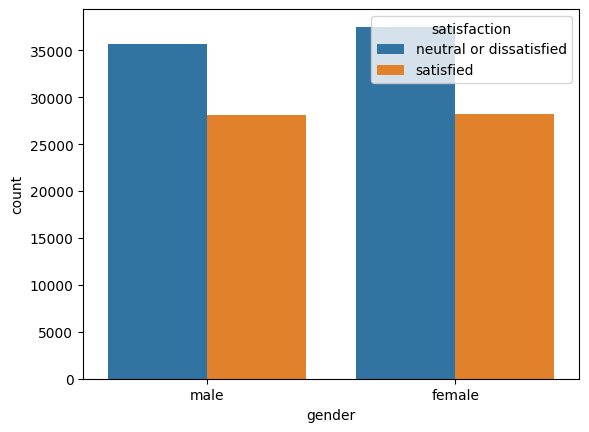

In [393]:
sns.countplot(data, x='gender', hue='satisfaction');

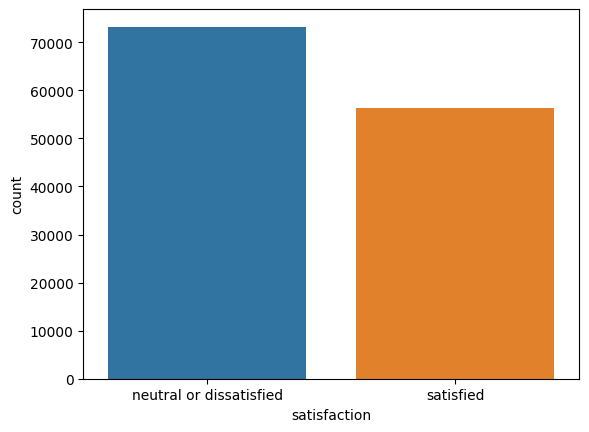

In [394]:
sns.countplot(data=y, x='satisfaction');

The target variable is not too heavily imbalanced.

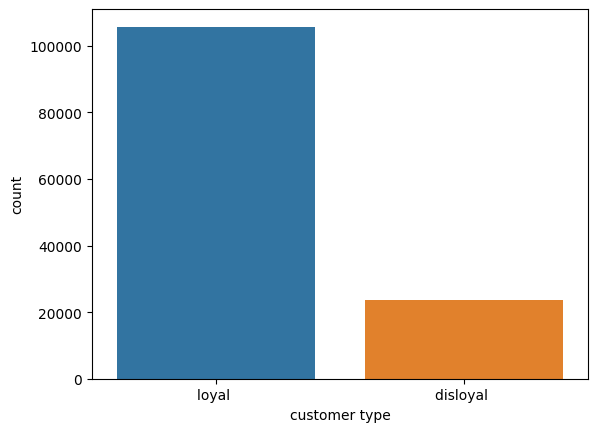

In [395]:
sns.countplot(data=data, x='customer type');

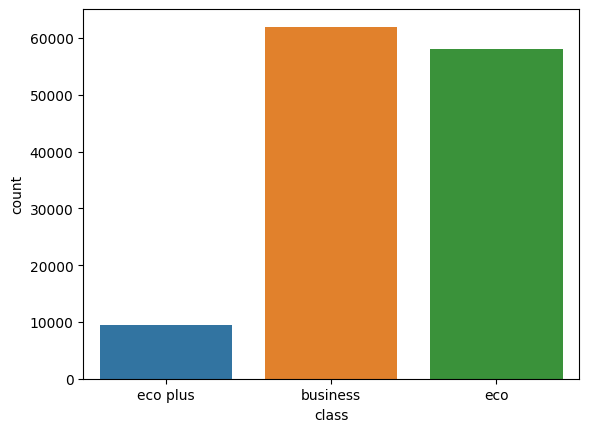

In [396]:
sns.countplot(data=data, x='class');

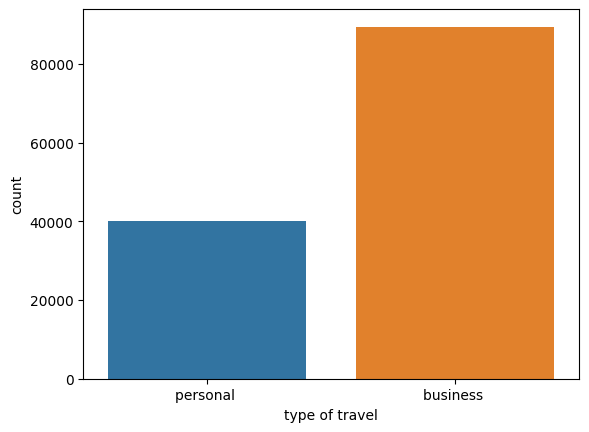

In [397]:
sns.countplot(data=data, x='type of travel');

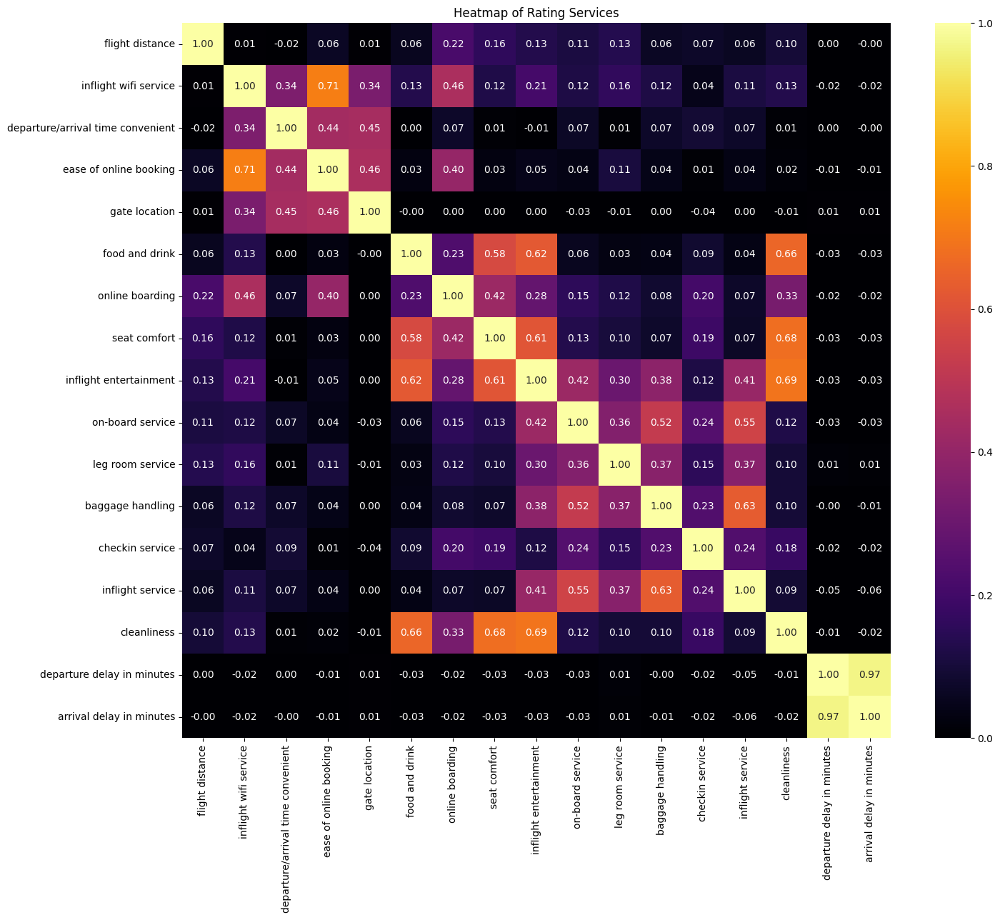

In [398]:
subset_corr = X.iloc[:,5:]
corr = subset_corr.corr()
plt.figure(figsize=(16, 13))
plt.title('Heatmap of Rating Services')
sns.heatmap(data=corr, annot=True, fmt=".2f", cmap='inferno', vmin=0, vmax=1.0);

As expected - The departure delay in minutes has an almost direct correlation with the arrival delay time in minutes.

This has the potential to be dropped if it is affecting the model too heavily. 

A second unexpected correlation was found between inflight wifi service and ease of booking online. 

In [399]:
subset_rating = X.iloc[:,5:-2]
for rating in subset_rating:
    fig = px.histogram(data_frame=subset_rating, x=rating, title=f"{(rating)}")
    fig.update_layout(bargap=0.1)
    fig.show()

### One Hot Encode

In [400]:
# one hot encode categorical variables
ohe = OneHotEncoder(handle_unknown='error')
X_object = data.select_dtypes(include='object')
ohe.fit(X_object)
codes = ohe.transform(X_object).toarray()
feature_names = ohe.get_feature_names_out(data.select_dtypes('object').columns)
data = pd.concat([data.select_dtypes(exclude='object'), pd.DataFrame(codes, columns=feature_names)], join='inner', axis=1)
print(data.shape)
data.head()

(129094, 29)


,age,flight distance,inflight wifi service,departure/arrival time convenient,ease of online booking,gate location,food and drink,online boarding,seat comfort,inflight entertainment,...,gender_male,customer type_disloyal,customer type_loyal,type of travel_business,type of travel_personal,class_business,class_eco,class_eco plus,satisfaction_neutral or dissatisfied,satisfaction_satisfied
0,13,460,3,4,3,1,5,3,5,5,...,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0
1,25,235,3,2,3,3,1,3,1,1,...,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
2,26,1142,2,2,2,2,5,5,5,5,...,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0
3,25,562,2,5,5,5,2,2,2,2,...,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
4,61,214,3,3,3,3,4,5,5,3,...,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0


In [401]:
data.isnull().sum()

age                                     0
flight distance                         0
inflight wifi service                   0
departure/arrival time convenient       0
ease of online booking                  0
gate location                           0
food and drink                          0
online boarding                         0
seat comfort                            0
inflight entertainment                  0
on-board service                        0
leg room service                        0
baggage handling                        0
checkin service                         0
inflight service                        0
cleanliness                             0
departure delay in minutes              0
arrival delay in minutes                0
gender_female                           0
gender_male                             0
customer type_disloyal                  0
customer type_loyal                     0
type of travel_business                 0
type of travel_personal           

In [402]:
data.dropna(inplace=True)
print(data.shape)

(129094, 29)


In [403]:
data = data.astype('int64')
data.head(2)

,age,flight distance,inflight wifi service,departure/arrival time convenient,ease of online booking,gate location,food and drink,online boarding,seat comfort,inflight entertainment,...,gender_male,customer type_disloyal,customer type_loyal,type of travel_business,type of travel_personal,class_business,class_eco,class_eco plus,satisfaction_neutral or dissatisfied,satisfaction_satisfied
0,13,460,3,4,3,1,5,3,5,5,...,1,0,1,0,1,0,0,1,1,0
1,25,235,3,2,3,3,1,3,1,1,...,1,1,0,1,0,1,0,0,1,0


In [404]:
X = data.iloc[:,:-2]
y = data.iloc[:,-1]
print(X.shape)
print(y.shape)
X.head()

(129094, 27)
(129094,)


,age,flight distance,inflight wifi service,departure/arrival time convenient,ease of online booking,gate location,food and drink,online boarding,seat comfort,inflight entertainment,...,arrival delay in minutes,gender_female,gender_male,customer type_disloyal,customer type_loyal,type of travel_business,type of travel_personal,class_business,class_eco,class_eco plus
0,13,460,3,4,3,1,5,3,5,5,...,18,0,1,0,1,0,1,0,0,1
1,25,235,3,2,3,3,1,3,1,1,...,6,0,1,1,0,1,0,1,0,0
2,26,1142,2,2,2,2,5,5,5,5,...,0,1,0,0,1,1,0,1,0,0
3,25,562,2,5,5,5,2,2,2,2,...,9,1,0,0,1,1,0,1,0,0
4,61,214,3,3,3,3,4,5,5,3,...,0,0,1,0,1,1,0,1,0,0


In [306]:
y = np.ravel(y)

### Split Train/Test

In [405]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=.20, random_state=0)

print(x_train.shape)
print(y_test.shape)

(103275, 27)
(25819,)


### Machine Learning